<a href="https://colab.research.google.com/github/kobejean/lar-lab-notebooks/blob/main/notebooks/iimoriyama_localization_opencv.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup

In [1]:
import os

In [2]:
if not os.path.exists("repo"):
  !git clone https://github.com/kobejean/lar-lab-notebooks.git repo


In [21]:
import json
import cv2
import numpy as np
import base64

class LARAnchor():
  
  def __init__(self, obj):
    self.id = obj["id"]
    self.transform = np.asarray(obj["transform"]).reshape((4,4)).transpose()
    

class LARLandmark():

  def __init__(self, obj):
    self.id = obj["id"]
    desc_bytes = base64.b64decode(obj["desc"])
    self.desc = np.asarray(list(desc_bytes), dtype=np.uint8)
    self.position = np.asarray(obj["position"], dtype=np.float64)

  @staticmethod
  def concatDescriptions(landmarks):
    return np.stack([landmark.desc for landmark in landmarks])

class LARMap():
  anchors = {}
  landmarks = []
  def __init__(self, obj):
    for id, anchor_obj in obj["anchors"]:
      self.anchors[id] = LARAnchor(anchor_obj)
      
    for landmark_obj in obj["landmarks"]:
      landmark = LARLandmark(landmark_obj)
      self.landmarks.append(landmark)

  @staticmethod
  def read(path):
    f = open(path)
    obj = json.loads(f.read())
    return LARMap(obj)


class LARFrame():
  def __init__(self, obj):
    self.id = obj["id"]
    self.intrinsics = np.asarray(obj["intrinsics"]).reshape((3,3)).transpose()

  
  @staticmethod
  def read(path):
    f = open(path)
    obj = json.loads(f.read())
    return [LARFrame(frame_obj) for frame_obj in obj]

# Read Pre-processed Map

In [22]:
map = LARMap.read("/content/repo/data/iimoriyama/cloudy_evening/map.json")
map_desc = LARLandmark.concatDescriptions(map.landmarks)
print(map_desc)

[[ 67 141 216 ... 254 255   3]
 [ 64 237   3 ...   1 160  53]
 [ 11 232 159 ...   6   0  55]
 ...
 [224 247   1 ... 184 255  10]
 [ 33 238  13 ... 121 255  33]
 [161  55  12 ... 249 255  11]]


# Read a Test Image and Camera Parameters

In [107]:
# Load files
img_id = 1
frames = LARFrame.read("/content/repo/data/iimoriyama/cloudy_afternoon/frames.json")

def load_img(img_id):
  return cv2.imread(f"/content/repo/data/iimoriyama/cloudy_afternoon/{img_id:08d}_image.jpeg")

img = load_img(img_id)
frame = frames[img_id]


# Feature Extraction and Matching

In [108]:
# Exctract features
akaze = cv2.AKAZE_create()
bf = cv2.BFMatcher(cv2.DescriptorMatcher_BRUTEFORCE_HAMMING)

def feature_extract_and_match(img, map_desc):
  kpts, desc = akaze.detectAndCompute(img, None)

  # Match features
  matches = bf.knnMatch(desc, map_desc, k=2)

  # Ratio test
  ratio = 0.7
  good = []
  for m, n in matches:
    if m.distance < ratio * n.distance:
      good.append(m)
      
  print(f"{len(good)} inliers found")
  return kpts, good

kpts, matches = feature_extract_and_match(img, map_desc)


62 inliers found


# PnP (Perspective-n-Point)

In [109]:
# Create PnP inputs
def solve_pnp(map, kpts, matches):
  img_points = []
  obj_points = []
  for match in matches:
    img_points.append(kpts[match.queryIdx].pt)
    obj_points.append(map.landmarks[match.trainIdx].position)
  img_points = np.asarray(img_points, np.float32)
  obj_points = np.asarray(obj_points, np.float32)

  # Solve PnP
  _, rvec, tvec, _ = cv2.solvePnPRansac(obj_points, img_points, frame.intrinsics, None)
  R, _ = cv2.Rodrigues(rvec)
  t = np.array(tvec).T[0]

  # flip axes
  # R[]
  print("Rotation matrix:", R)
  print("Translation vector:", t)
  return R, t

R, t = solve_pnp(map, kpts, matches)

Rotation matrix: [[ 0.9339251  -0.02017635 -0.3568989 ]
 [-0.01194873 -0.99960993  0.02524317]
 [-0.357269   -0.01931074 -0.93380188]]
Translation vector: [-10.69478967   1.45381573  11.32647607]


tsuruga pixel coords (967, 708)


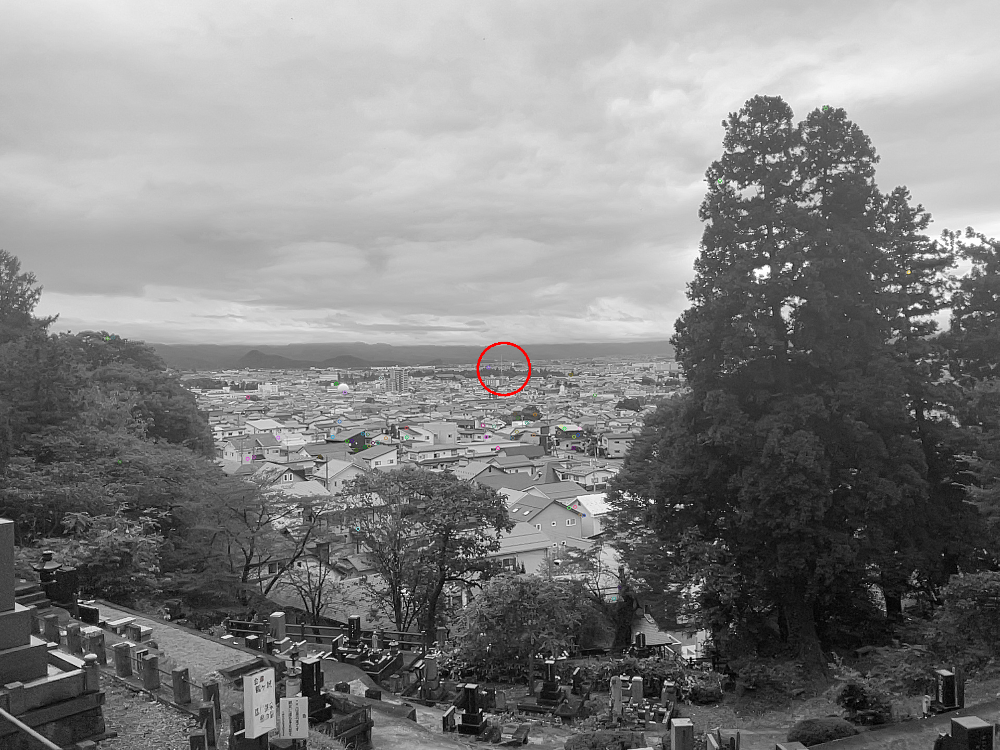

In [110]:
from google.colab.patches import cv2_imshow


def imageCoordinates(point3d, R, t, intrinsics):
  point3d = np.matmul(R, point3d) + t

  coords = np.matmul(intrinsics, point3d)
  coords = coords / coords[2]
  return (int(coords[0]), int(coords[1]))
  
# Visualize Results
tsuruga = map.anchors[0].transform[0:3,3].T

def visualize_results(img, frame, kpts, matches, R, t):
  coords = imageCoordinates(tsuruga, R, t, frame.intrinsics)
  print("tsuruga pixel coords", coords)

  good_kpts = []
  for match in matches:
    good_kpts.append(kpts[match.queryIdx])

  result = cv2.drawKeypoints(img, good_kpts, None)
  result = cv2.circle(result, coords, 50, (0, 0, 255), 4)

  cv2_imshow(result)

visualize_results(img, frame, kpts, matches, R, t)

Localizing image 0
19 inliers found
Rotation matrix: [[ 0.97341565 -0.17816843 -0.14393742]
 [ 0.22063868  0.89809718  0.38044715]
 [ 0.06148612 -0.40209137  0.91353269]]
Translation vector: [ 35.53719767  39.55922302 865.67540695]
tsuruga pixel coords (1481, 1950)


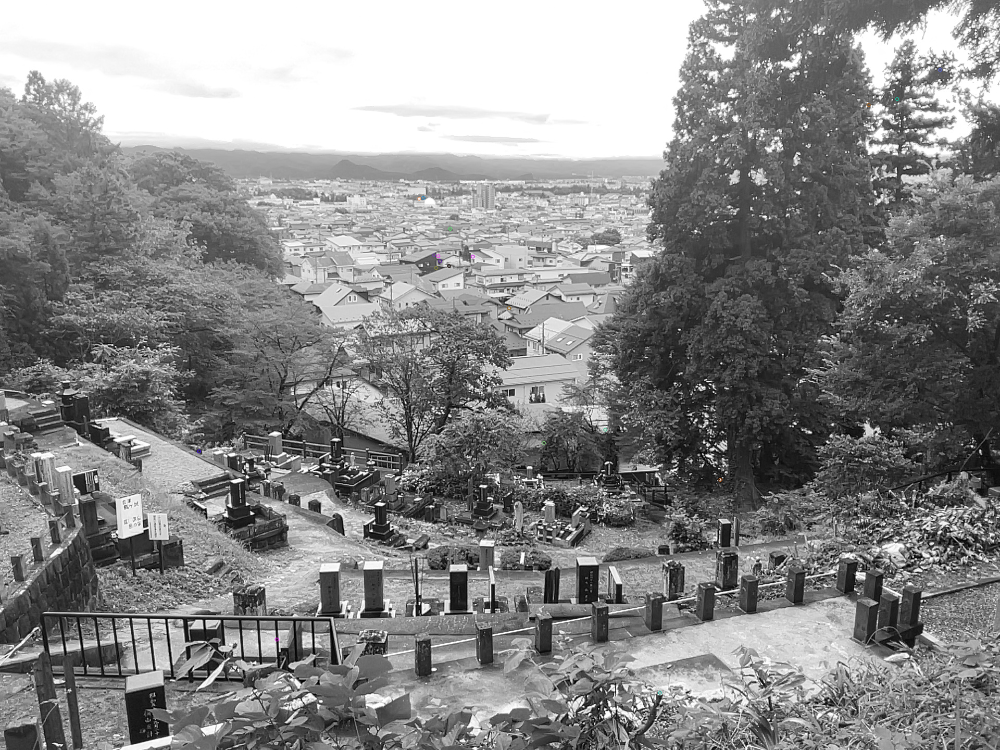

Localizing image 1
62 inliers found
Rotation matrix: [[ 0.9339251  -0.02017635 -0.3568989 ]
 [-0.01194873 -0.99960993  0.02524317]
 [-0.357269   -0.01931074 -0.93380188]]
Translation vector: [-10.69478967   1.45381573  11.32647607]
tsuruga pixel coords (967, 708)


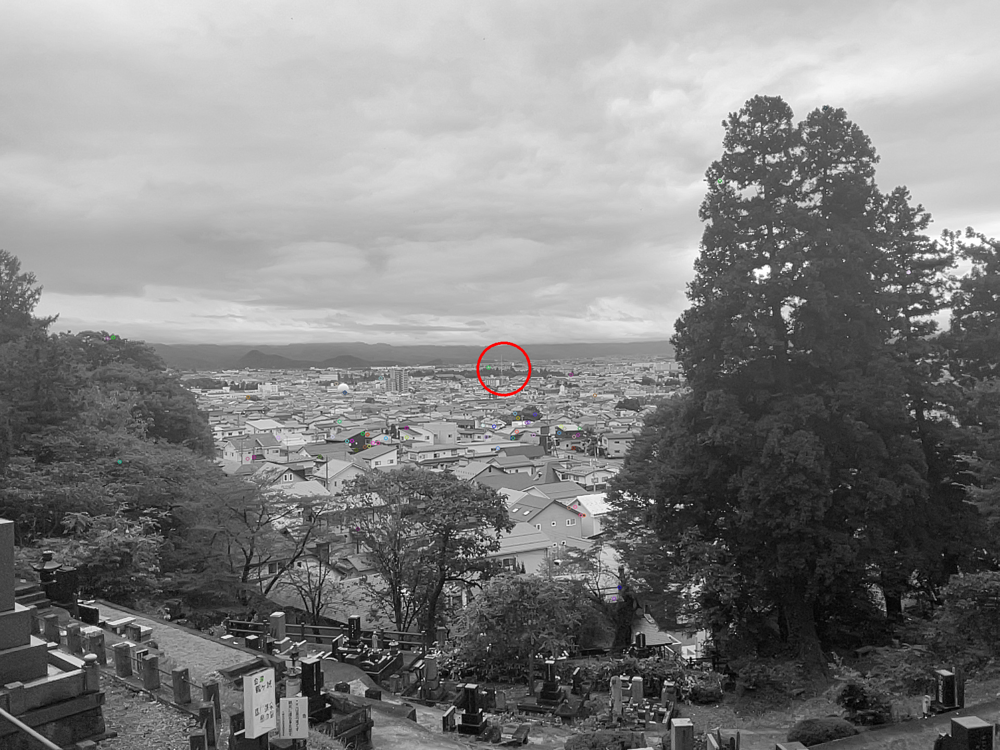

Localizing image 2
113 inliers found
Rotation matrix: [[ 0.93735479  0.01093796 -0.34820448]
 [ 0.04788407 -0.99406562  0.09767626]
 [-0.34506972 -0.10823076 -0.93231593]]
Translation vector: [-7.83240994 -1.10092323  7.15044754]
tsuruga pixel coords (953, 564)


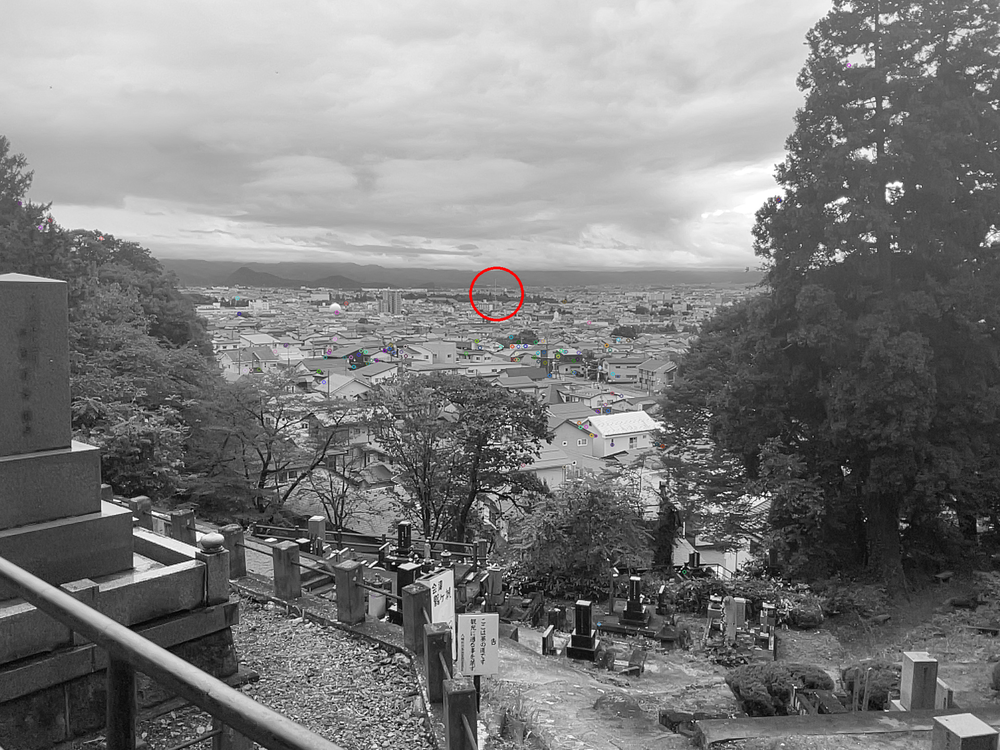

Localizing image 3
61 inliers found
Rotation matrix: [[ 0.92925148  0.04612251 -0.3665575 ]
 [ 0.01128404 -0.99525705 -0.09662341]
 [-0.36927545  0.0856512  -0.92536453]]
Translation vector: [-5.80590955  0.45823158  5.35171142]
tsuruga pixel coords (986, 877)


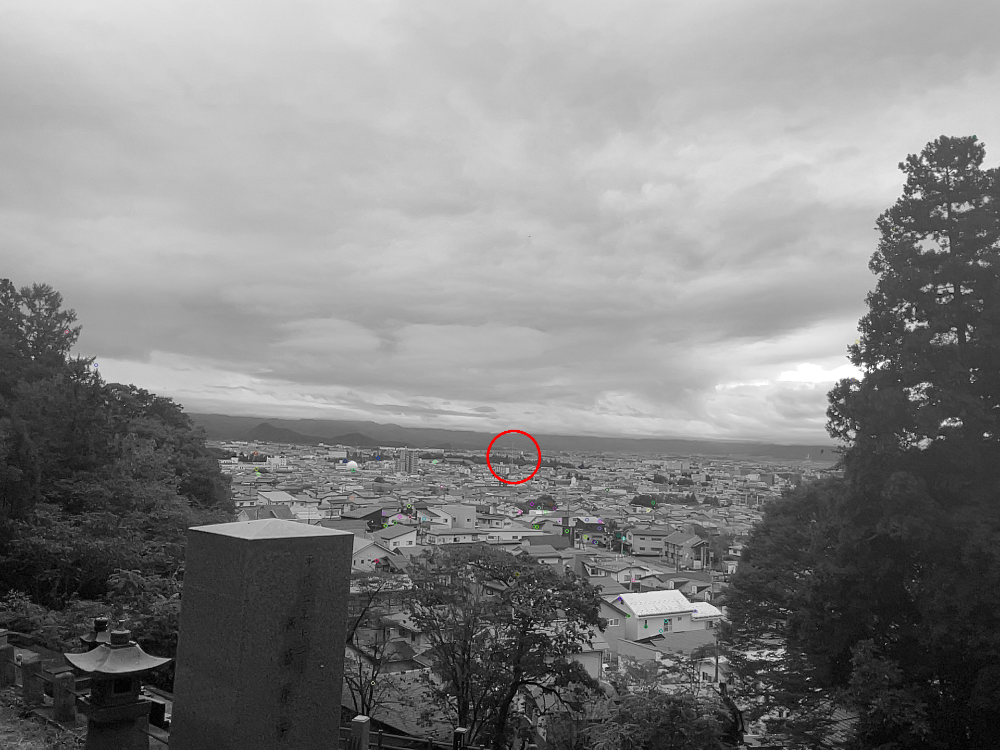

Localizing image 4
23 inliers found
Rotation matrix: [[ 0.99255732 -0.0021036   0.12176016]
 [ 0.01385378 -0.99140927 -0.13006053]
 [ 0.12098775  0.13077937 -0.98400138]]
Translation vector: [-6.83455549  0.42362801  1.55112333]
tsuruga pixel coords (120, 954)


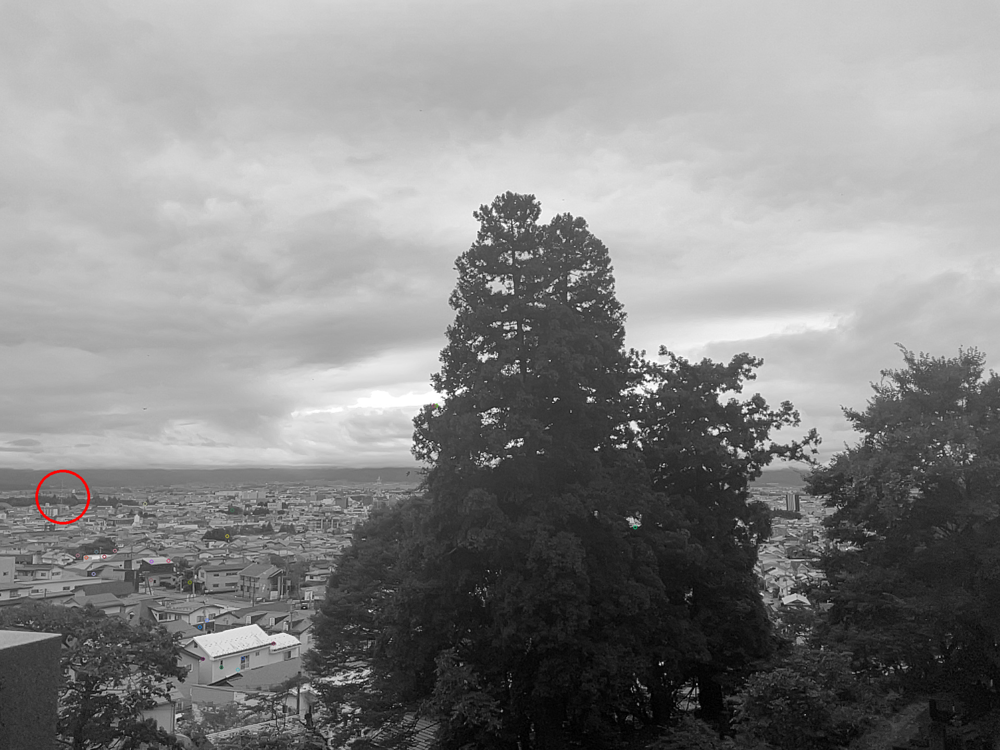

Localizing image 5
36 inliers found
Rotation matrix: [[ 0.87573502  0.04641824 -0.48055543]
 [-0.03519165 -0.98658212 -0.15942794]
 [-0.48150776  0.15652817 -0.86235098]]
Translation vector: [-4.39210408  1.05117467  5.42527022]
tsuruga pixel coords (1193, 1004)


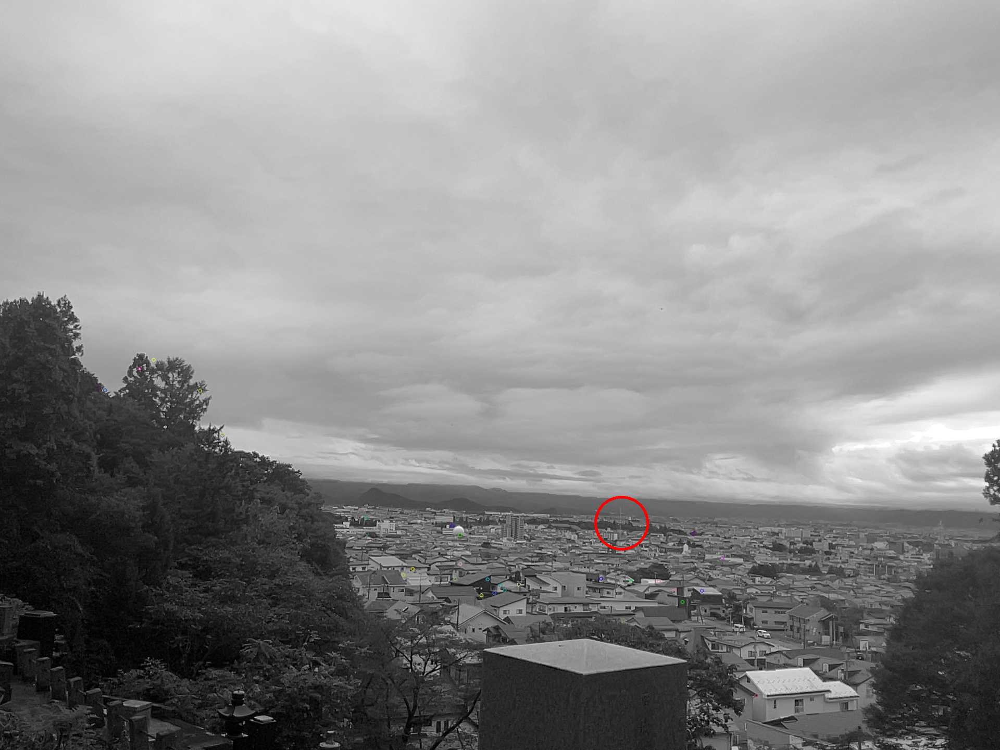

Localizing image 6
37 inliers found
Rotation matrix: [[ 0.95693266  0.0247471  -0.28925329]
 [ 0.01874672 -0.99954813 -0.02349692]
 [-0.28970407  0.01706241 -0.95696417]]
Translation vector: [-3.8423299  -0.20153369  1.97484012]
tsuruga pixel coords (856, 763)


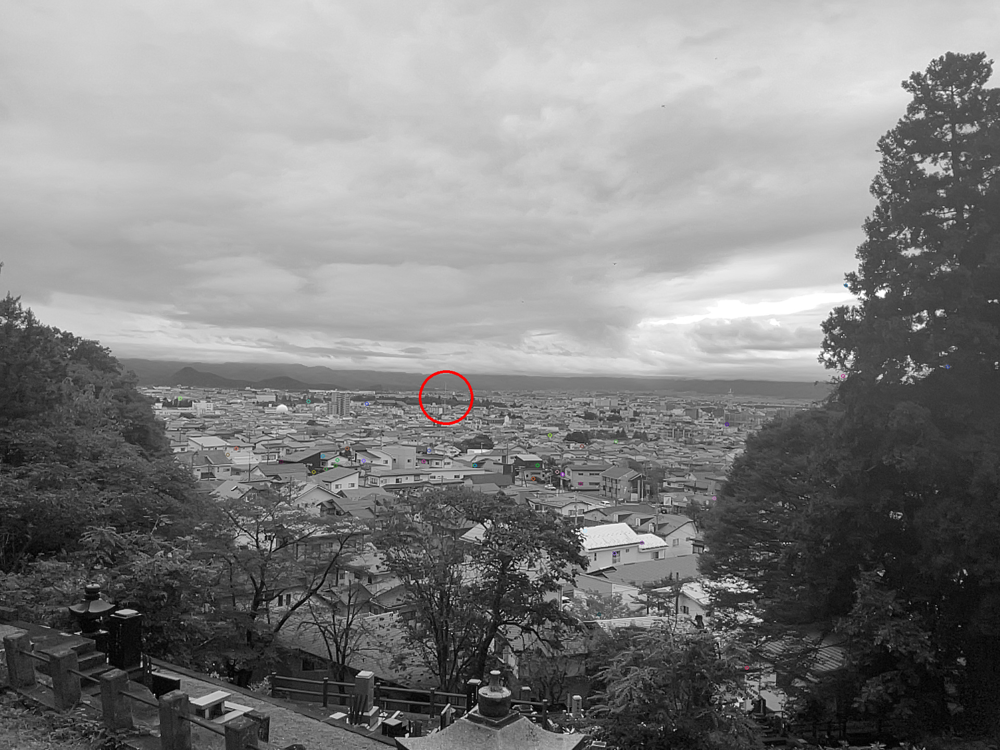

Localizing image 7
13 inliers found
Rotation matrix: [[ 0.98571955  0.03843558  0.16395022]
 [ 0.05712263 -0.99219595 -0.11083408]
 [ 0.15841077  0.11861659 -0.98022249]]
Translation vector: [ 0.55579438 -1.45902609 -6.76001886]
tsuruga pixel coords (36, 897)


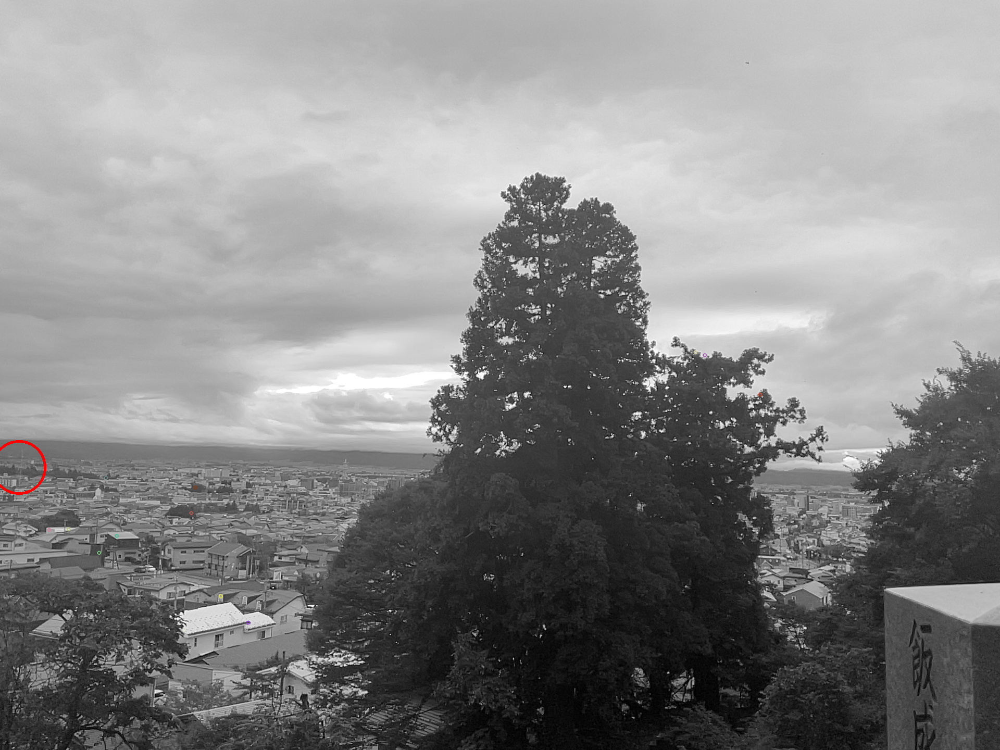

Localizing image 8
27 inliers found
Rotation matrix: [[ 0.84559114  0.00103432 -0.53383008]
 [-0.02657749 -0.99867645 -0.04403394]
 [-0.53316907  0.05142258 -0.84444447]]
Translation vector: [-2.74639035  0.41711353  4.14294148]
tsuruga pixel coords (1293, 821)


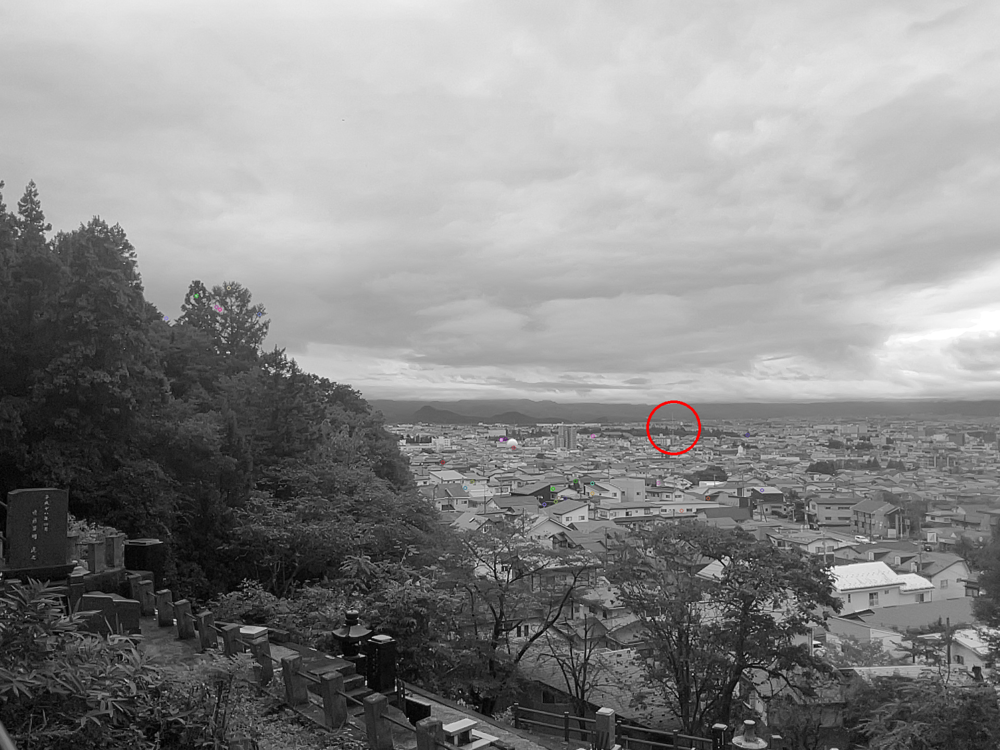

Localizing image 9
22 inliers found
Rotation matrix: [[ 9.65457246e-01  8.27033663e-04 -2.60560210e-01]
 [ 2.28044650e-02 -9.96425902e-01  8.13349750e-02]
 [-2.59561675e-01 -8.44673771e-02 -9.62025467e-01]]
Translation vector: [-2.41449446 -0.37846724  1.58694691]
tsuruga pixel coords (809, 603)


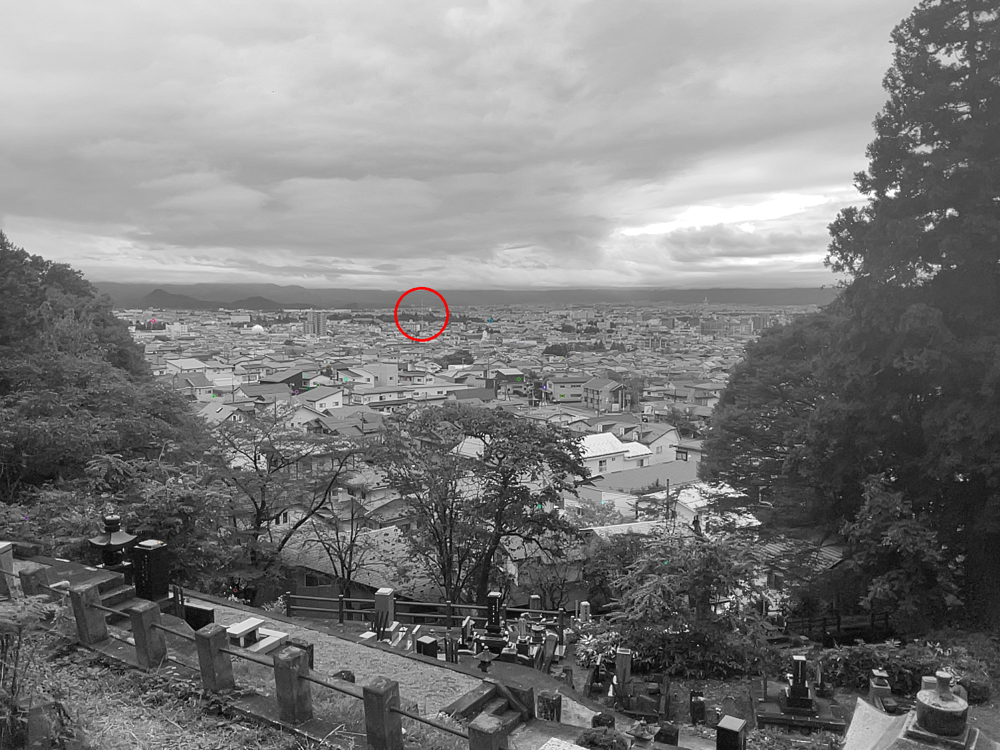

Localizing image 10
12 inliers found
Rotation matrix: [[ 0.89471891  0.01196885 -0.44646929]
 [ 0.03577588 -0.99834929  0.04493089]
 [-0.44519452 -0.05617334 -0.89367018]]
Translation vector: [ 1.66088481 -0.03957336 -7.77596582]
tsuruga pixel coords (1131, 650)


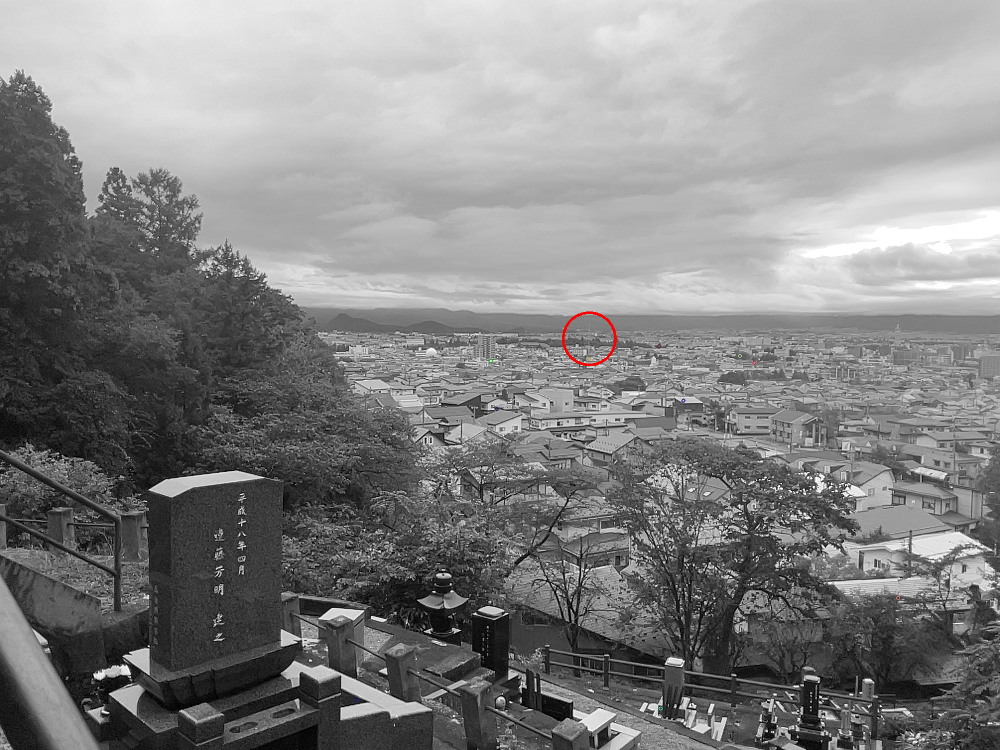

Localizing image 11
19 inliers found
Rotation matrix: [[-0.93129714  0.36272727 -0.03338496]
 [-0.36407569 -0.92398897  0.11701827]
 [ 0.01159839  0.12113343  0.99256847]]
Translation vector: [  6.56038179 -53.02506195  10.48137429]
tsuruga pixel coords (355, 695)


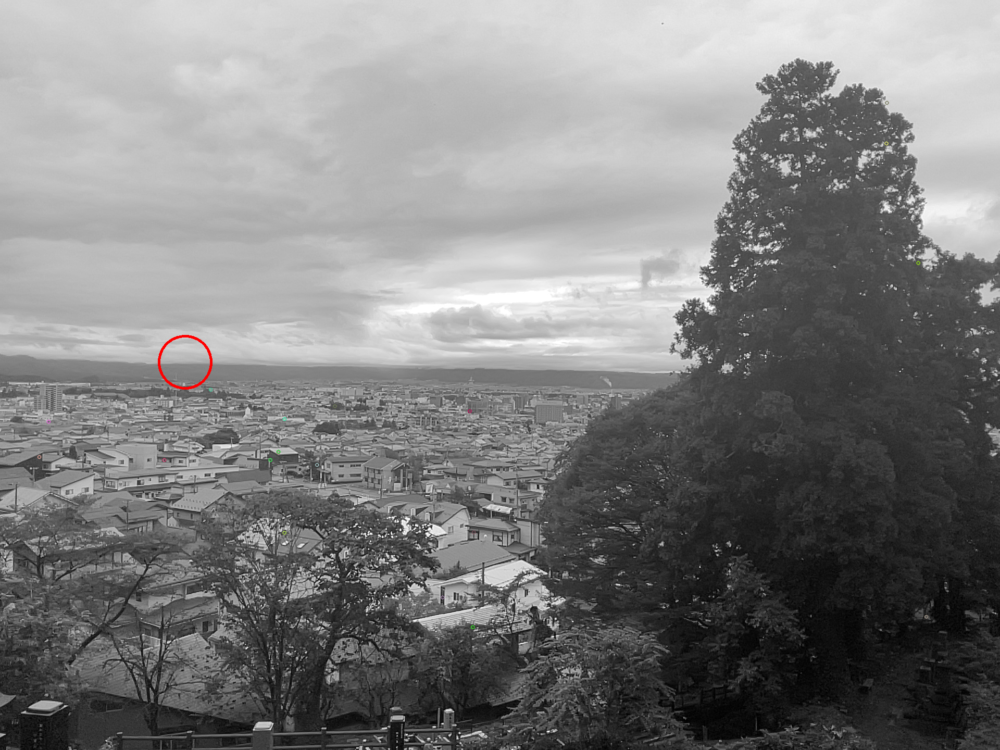

In [112]:
def localize(img_id):
  img = load_img(img_id)
  frame = frames[img_id]

  kpts, matches = feature_extract_and_match(img, map_desc)

  R, t = solve_pnp(map, kpts, matches)
  visualize_results(img, frame, kpts, matches, R, t)


for i in range(len(frames)):
  print("Localizing image", i)
  localize(i)